<a href="https://colab.research.google.com/github/yuvalofek/Digital-Image-Processing/blob/main/Image_Noise.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Noise and Denoising
Following the noise chapter in Woods

In [ ]:
import numpy as np
import numpy.random as npr
import matplotlib.pyplot as plt
import cv2
import seaborn as sns
import scipy.stats as stt

#collab patch for imshow:
from google.colab.patches import cv2_imshow as imshow
DIR = '/content/drive/MyDrive/DIP/'
IMG = 'PaprikaMovie.jpg'

Input Image Shape: (720, 1280, 3)
Resized Image Shape: (360, 640, 3)


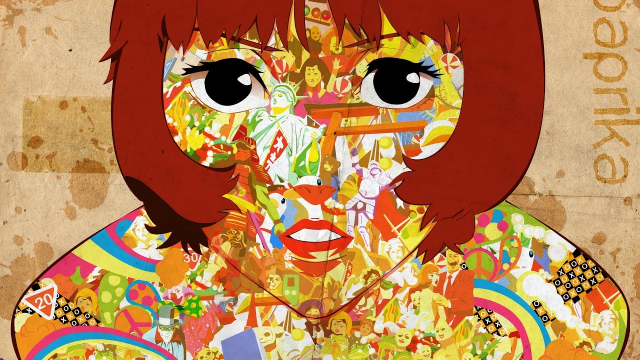

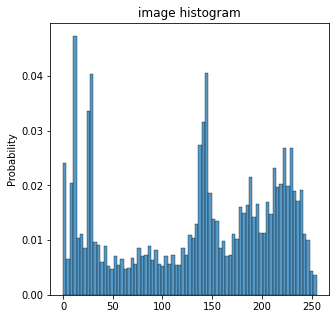

In [ ]:
img = cv2.imread(DIR+IMG)
shp = img.shape
print('Input Image Shape:', shp)

#Resize image to make it nicer when printing
img = cv2.resize(img, (640,360) )
print('Resized Image Shape:', img.shape)
imshow(img)

plt.figure(figsize=(5,5))
sns.histplot(img.flatten(),stat = 'probability')
plt.title('image histogram')
plt.show()

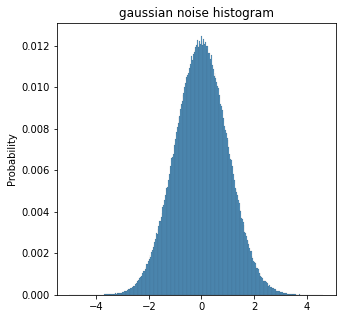

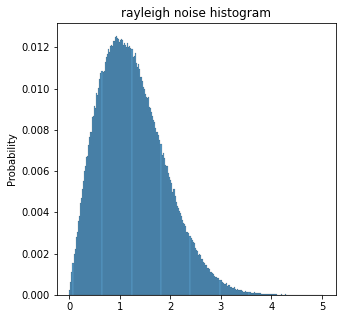

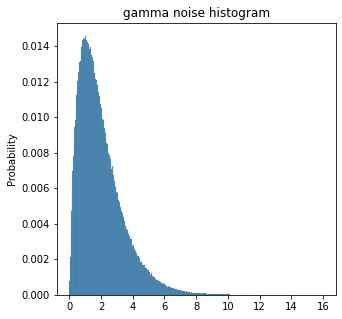

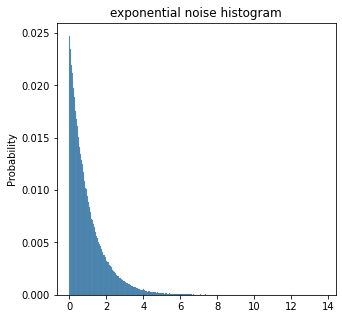

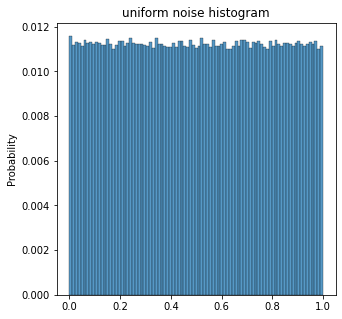

In [ ]:
## Noise models

gaussian = npr.normal(size = img.shape)
rayleigh = npr.rayleigh(size = img.shape) 
gamma = npr.gamma(2, size = img.shape)
exponential = npr.exponential(size = img.shape)
uniform = npr.uniform(size = img.shape)



plt.figure(figsize = (5,5))
sns.histplot(gaussian.flatten(), stat='probability')
plt.title('gaussian noise histogram')
plt.figure(figsize = (5,5))
sns.histplot(rayleigh.flatten(), stat='probability')
plt.title('rayleigh noise histogram')
plt.figure(figsize = (5,5))
sns.histplot(gamma.flatten(), stat='probability')
plt.title('gamma noise histogram')
plt.figure(figsize = (5,5))
sns.histplot(exponential.flatten(), stat='probability')
plt.title('exponential noise histogram')
plt.figure(figsize = (5,5))
sns.histplot(uniform.flatten(), stat='probability')
plt.title('uniform noise histogram')
plt.show()


gaussian


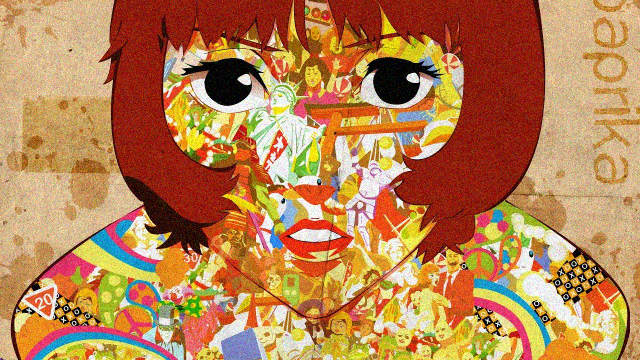

rayleigh


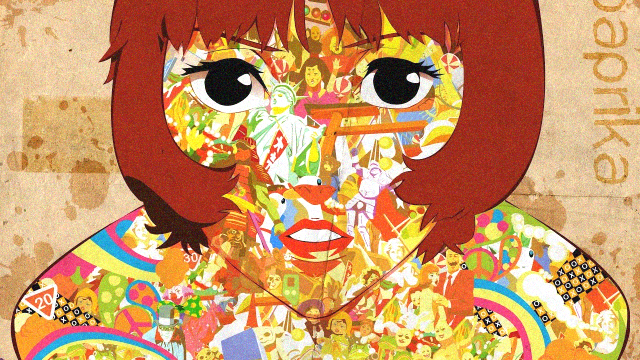

gamma


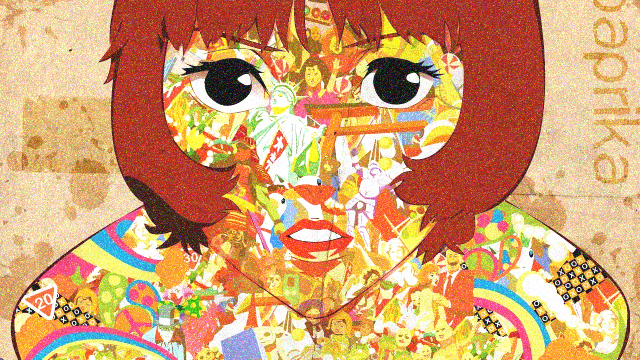

exponential


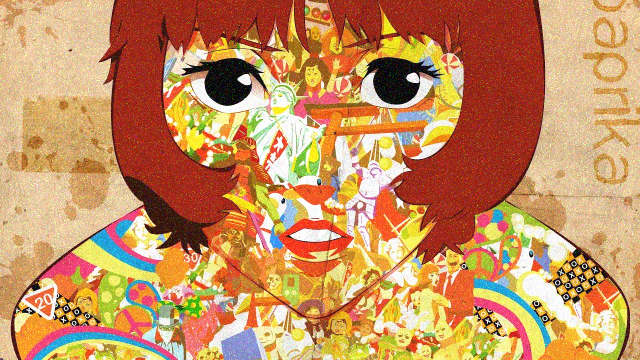

uniform


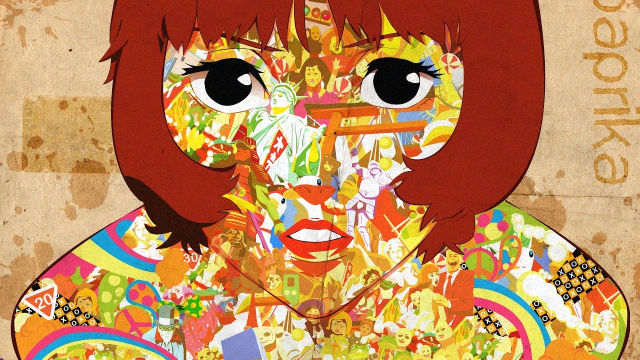

In [ ]:
## Adding noise to our image:
noise_multiplier = 15

noised = {'gaussian': img+gaussian*noise_multiplier,
          'rayleigh': img+rayleigh*noise_multiplier,
          'gamma': img+gamma*noise_multiplier,
          'exponential': img+exponential*noise_multiplier,
          'uniform':img+uniform*noise_multiplier }

for key, imag in noised.items():
  print(key)
  imshow(imag)

## I tried choosing a value so the noise is almost not noticable

gaussian


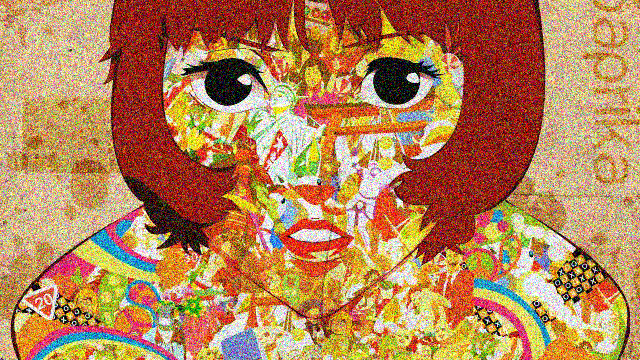

rayleigh


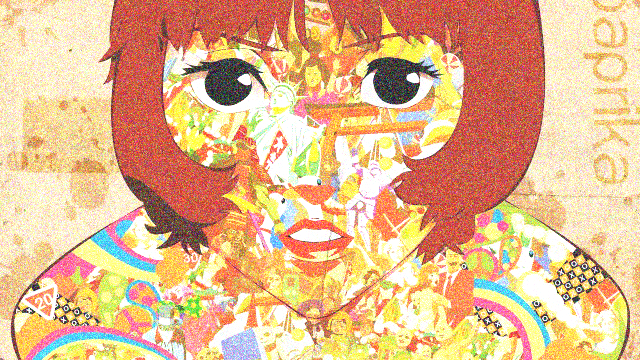

gamma


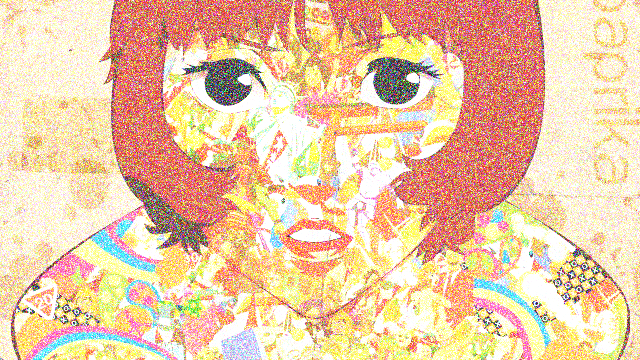

exponential


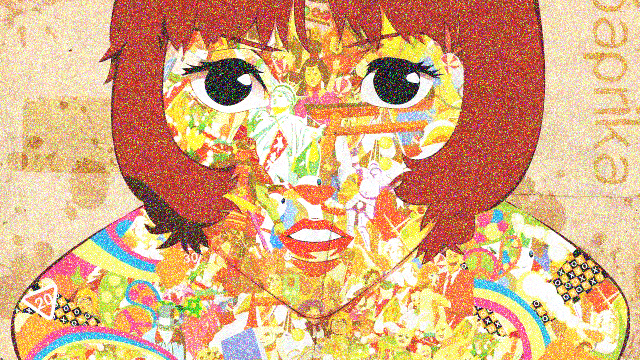

uniform


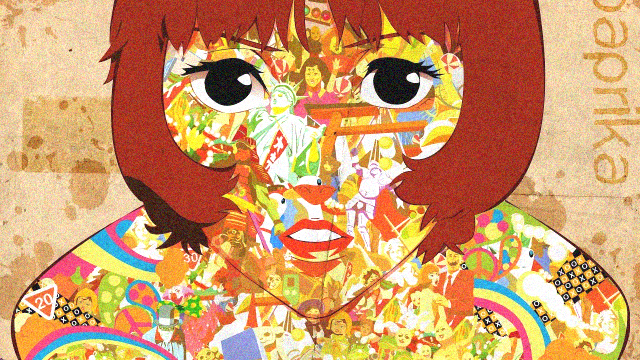

In [ ]:
## Can't see anything, which makes sense because the noise magnitude was really
## low
## Try again with more noise
noise_multiplier = 50

noised_h = {'gaussian': img+gaussian*noise_multiplier,
          'rayleigh': img+rayleigh*noise_multiplier,
          'gamma': img+gamma*noise_multiplier,
          'exponential': img+exponential*noise_multiplier,
          'uniform':img+uniform*noise_multiplier }

for key, imag in noised_h.items():
  print(key)
  imshow(imag)

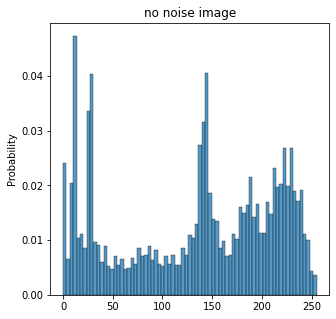

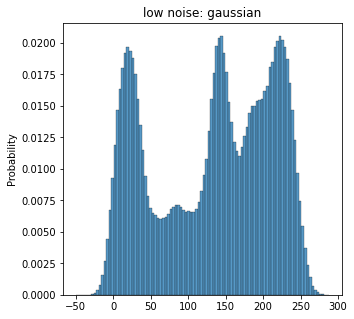

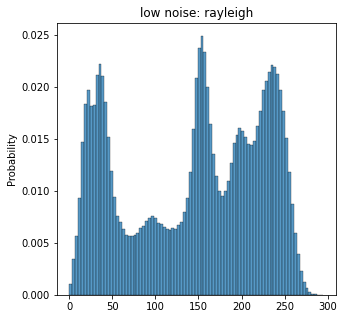

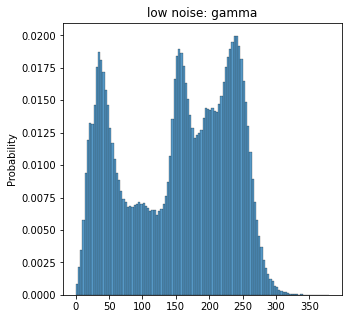

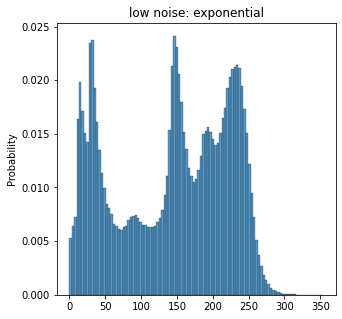

...

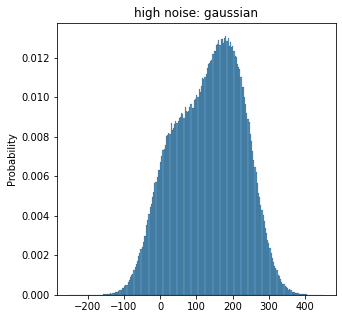

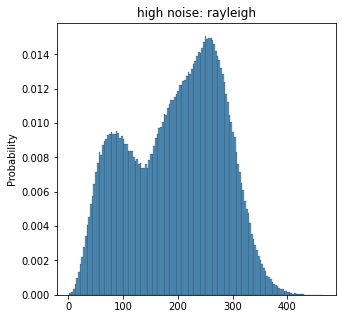

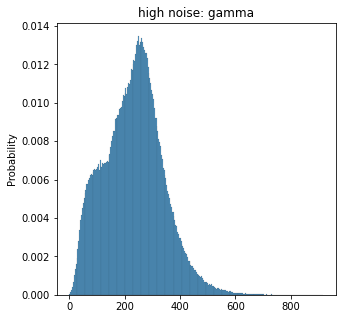

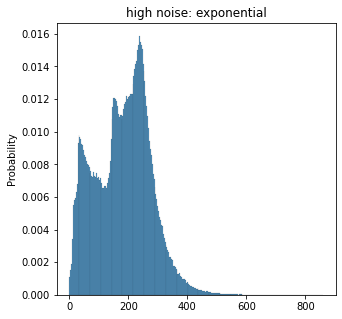

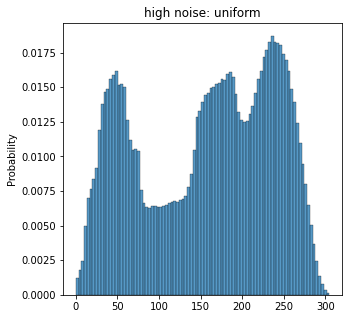

In [ ]:
### Image histograms:
plt.figure(figsize=(5,5))
sns.histplot(img.flatten(), stat='probability')
plt.title('no noise image')
plt.show()

for key, imag in noised.items():
  plt.figure(figsize=(5,5))
  sns.histplot(imag.flatten(), stat='probability')
  plt.title('low noise: '+key)
  plt.show()
for key, imag in noised_h.items():
  plt.figure(figsize=(5,5))
  sns.histplot(imag.flatten(), stat='probability')
  plt.title('high noise: '+key)
  plt.show()

## We see that the level of noise has a high impact on whether or not
## we can notice the noise histogram in the image one. The histograms
## for the low noise are very similar, while for high noise they 
## resemble the histogram of the noise distribution.

selected image segment


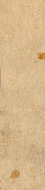

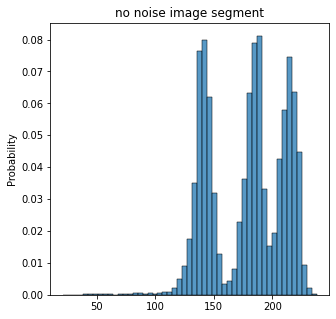

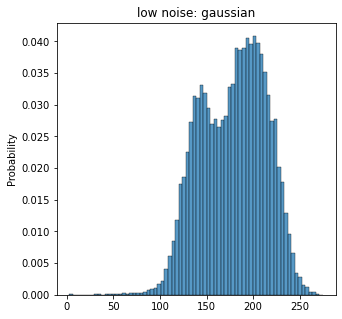

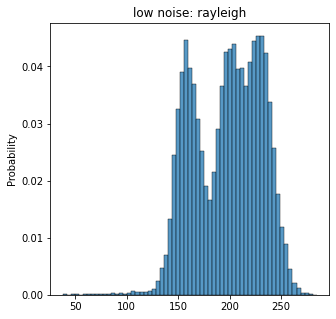

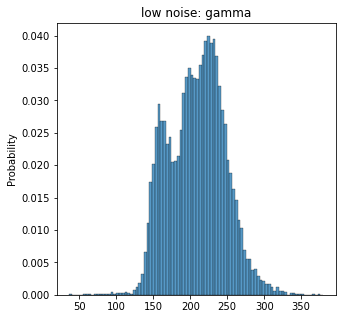

...

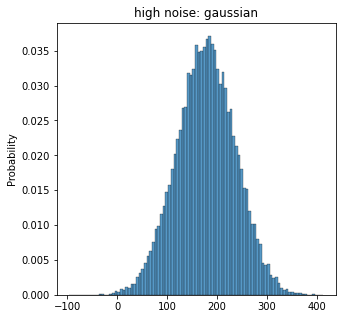

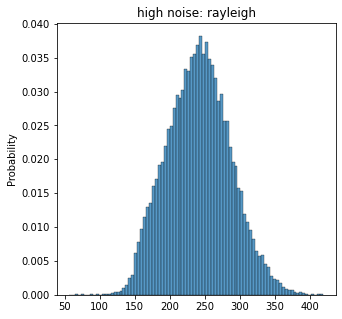

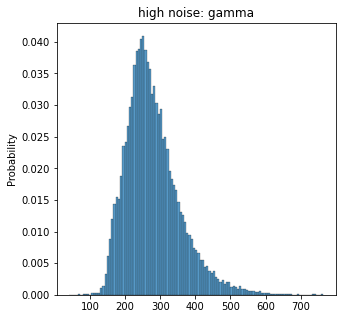

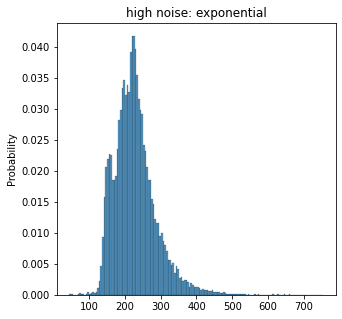

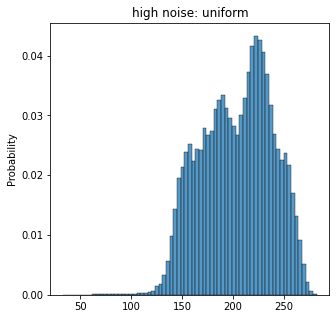

In [ ]:
## We also continue to see if we can take a segment of the image that is of 
## similar base color and compute its histogram, hoping it gives us a better
## indication of the underlying noise distribution for low noise power.

img_seg = img[0:190, 545:590]
print('selected image segment')
imshow(img_seg)

### Image histograms:
plt.figure(figsize=(5,5))
sns.histplot(img[0:190, 545:590].flatten(), stat='probability')
plt.title('no noise image segment')
plt.show()

for key, imag in noised.items():
  plt.figure(figsize=(5,5))
  sns.histplot(imag[0:190, 545:590].flatten(), stat='probability')
  plt.title('low noise: '+key)
  plt.show()
for key, imag in noised_h.items():
  plt.figure(figsize=(5,5))
  sns.histplot(imag[0:190, 545:590].flatten(), stat='probability')
  plt.title('high noise: '+key)
  plt.show()

## We still have a hard time picking out the noise distribution for the low noise
## power images, but the determining the noise distr for the higher noise images
## is much easier

In [ ]:
def filter2d(image, func, size = (3,3)):
  '''
  divides image into boxes of size 'size' and performs func on the boxes
  '''
  y_fsz, x_fsz = size
  out = np.zeros((image.shape[0]-y_fsz,image.shape[1]-x_fsz))

  for y in range(image.shape[0]-y_fsz):
    for x in range(image.shape[1]-x_fsz):
      box = image[y:y+y_fsz, x:x+x_fsz]
      out[y,x] = func(box.flatten())
  return out

def filterimage(image, func, size = (3,3)):
  '''
  performs a filter2d on each of the channels of a color image
  '''
  y_fsz, x_fsz = size
  out = np.zeros((image.shape[0]-y_fsz,image.shape[1]-x_fsz, image.shape[2]))
  for dim in range(image.shape[2]):
    out[:,:,dim] = filter2d(image[:,:,dim], func, size = size)
  return out


In [ ]:
def trim_mean(arr):
  return stt.trim_mean(arr, 0.1)

def midpoint(arr):
  return (0.5*(arr.max()+arr.min()))

def try_denoising(img, size = (3,3)):
  denoise = {'mean': filterimage(img,np.mean, size=size),
            'geom_mean': filterimage(img, stt.mstats.gmean, size=size),
            'h_mean': filterimage(img, stt.hmean, size=size),
            'alpha-trimmed mean': filterimage(img, trim_mean, size=size),
            'median': filterimage(img, np.median, size=size),
            'max': filterimage(img, max, size=size), 
            'min': filterimage(img, min, size=size), 
            'midpoint': filterimage(img, midpoint, size=size)
            }
  return denoise

/usr/local/lib/python3.6/dist-packages/scipy/stats/stats.py:338: RuntimeWarning: divide by zero encountered in log
  log_a = np.log(a)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in ubyte_scalars
  """


mean


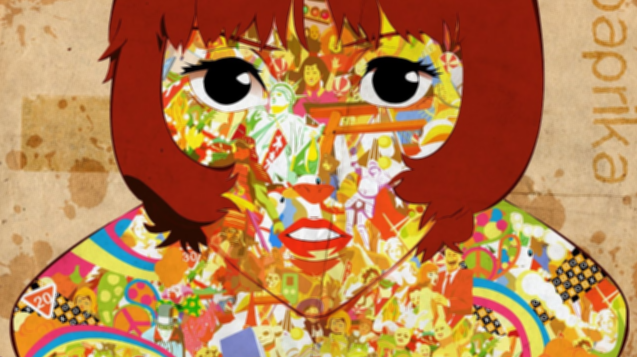

geom_mean


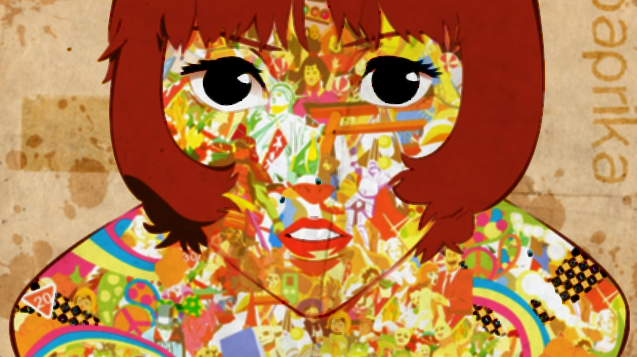

h_mean


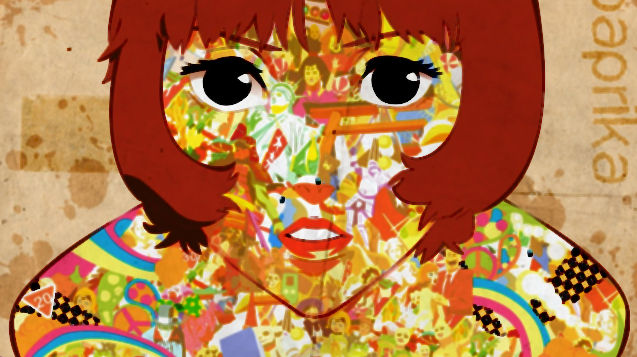

alpha-trimmed mean


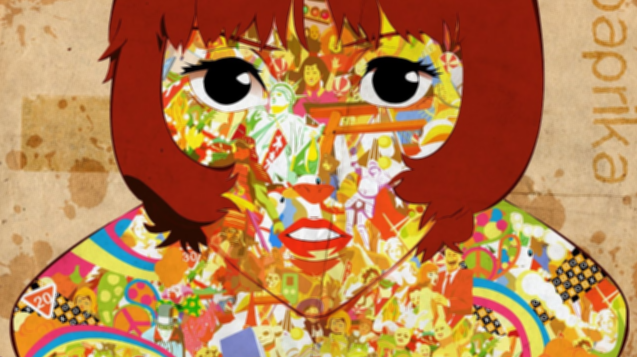

median


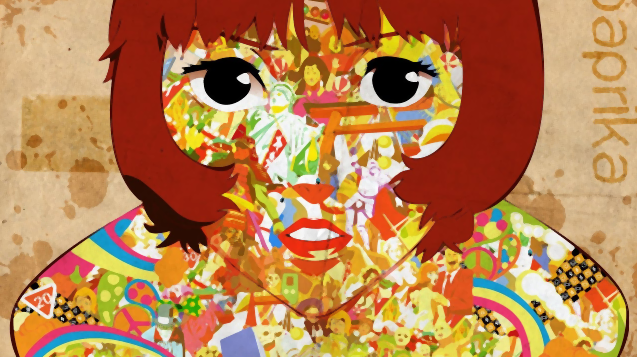

max


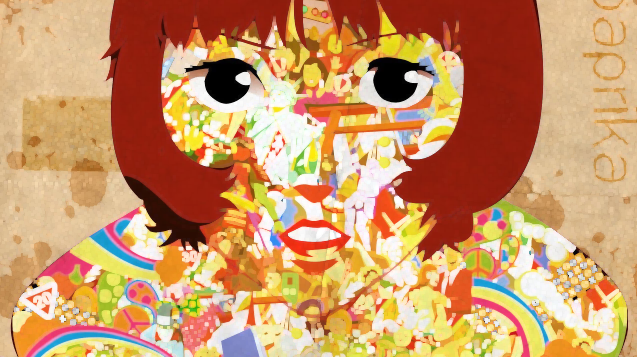

min


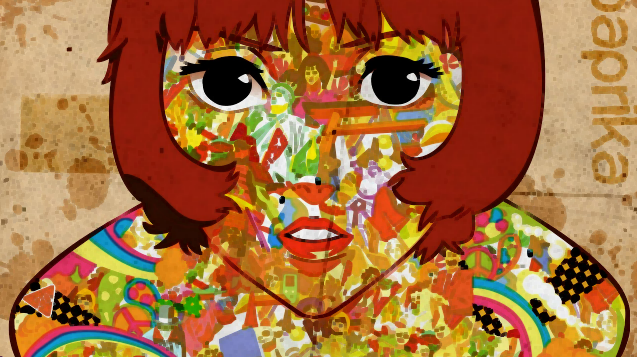

midpoint


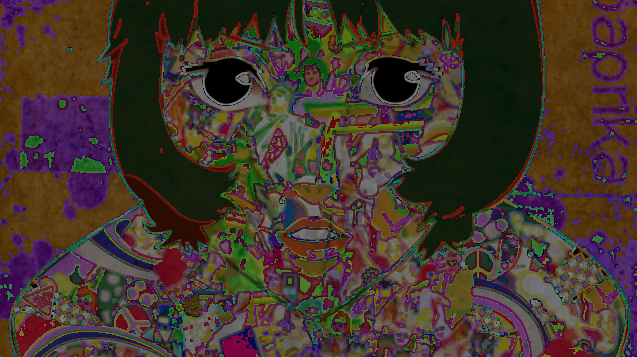

In [ ]:
denoise = try_denoising(img)
for key, image in denoise.items():
  print(key)
  imshow(image)

## Here I attempted to use the denoising filters outlined in the chapter
## on the no noise image to see what they do. The results were generally 
## smoother images all round. The means and median all looked very similar, 
## while the min was darker and min was lighter (as expected). 
## The midpoint came out varstly different than expected, it was much darker 
## than the original image and the colors seemed to change

In [ ]:
## Clippping values under 0 for some of the denoising functions
for key, image in noised_h.items():
  #if an element is less than zero replace with a zero
  noised_h[key][image<0] = 0

~~~~~~~~~~~gaussian~~~~~~~~~~~


/usr/local/lib/python3.6/dist-packages/scipy/stats/stats.py:338: RuntimeWarning: divide by zero encountered in log
  log_a = np.log(a)


mean


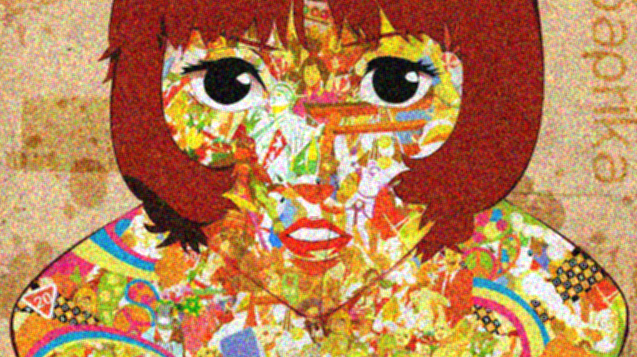

geom_mean


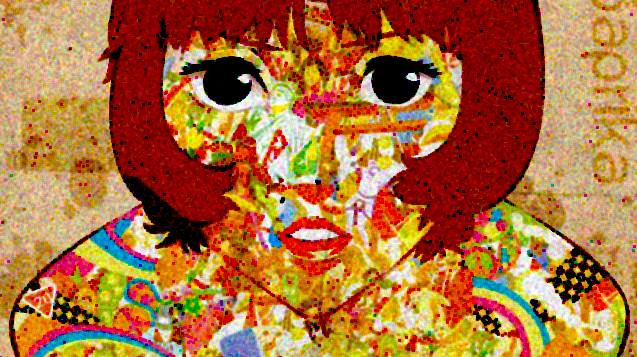

h_mean


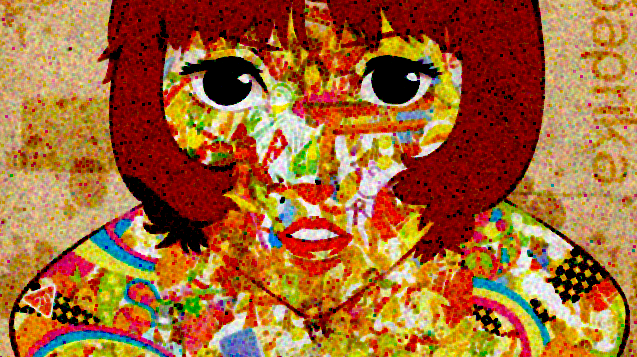

alpha-trimmed mean


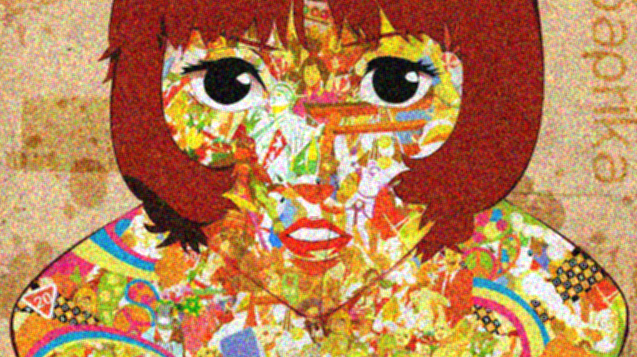

median


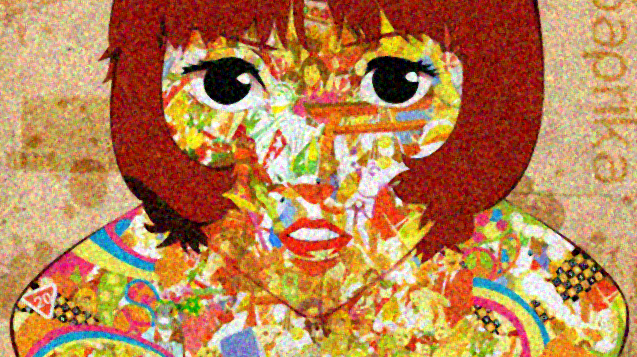

max


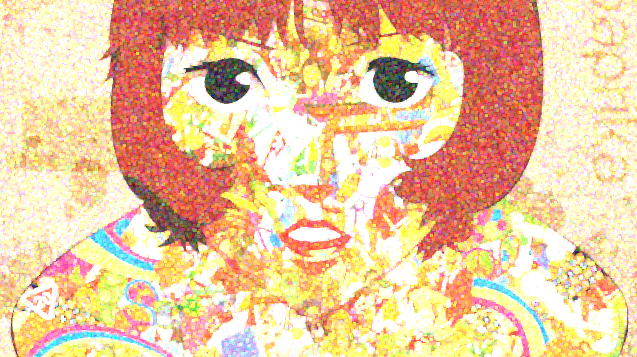

min


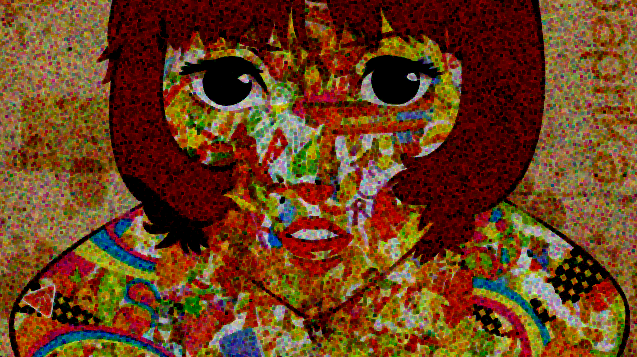

midpoint


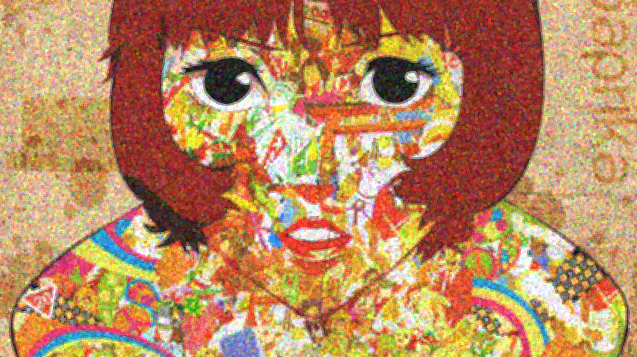

~~~~~~~~~~~rayleigh~~~~~~~~~~~
mean


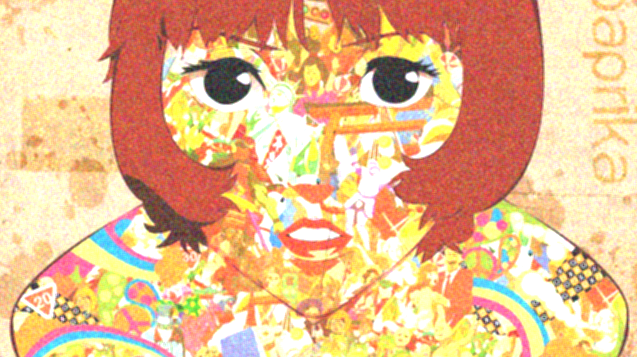

geom_mean


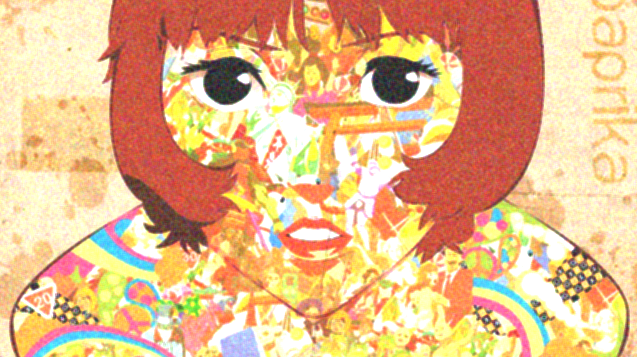

h_mean


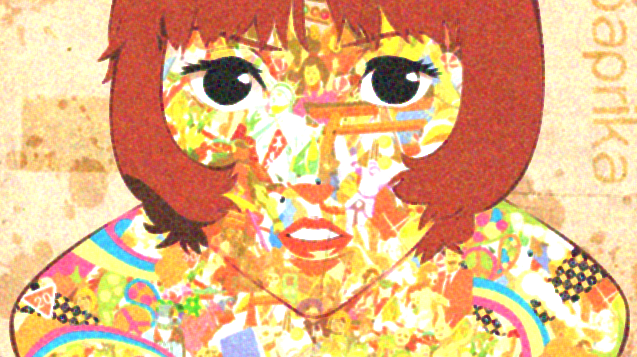

alpha-trimmed mean


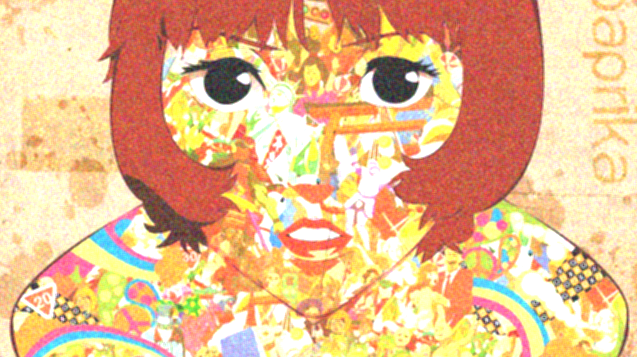

median


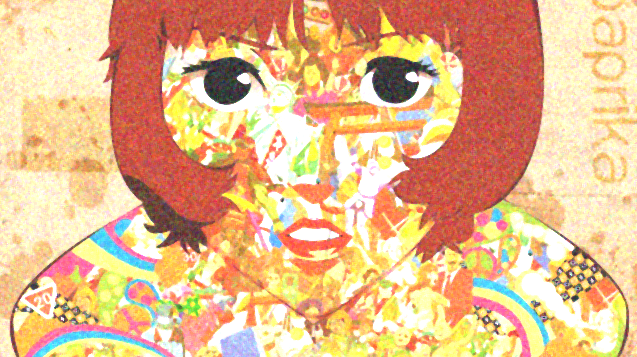

max


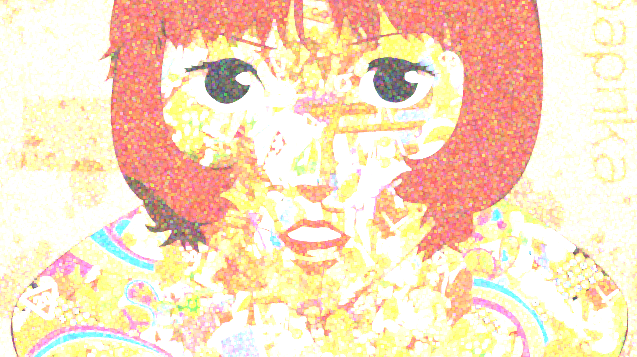

min


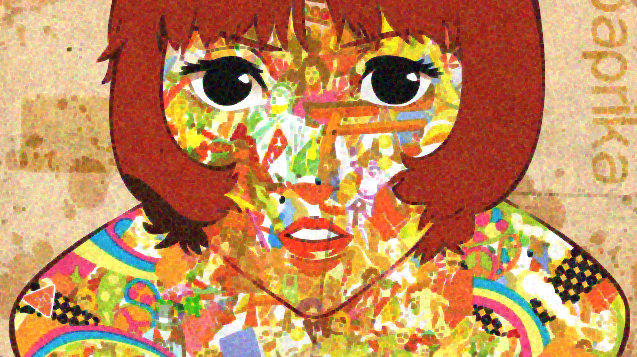

midpoint


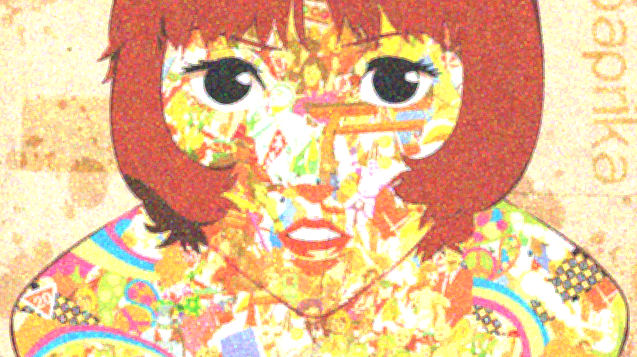

~~~~~~~~~~~gamma~~~~~~~~~~~
mean


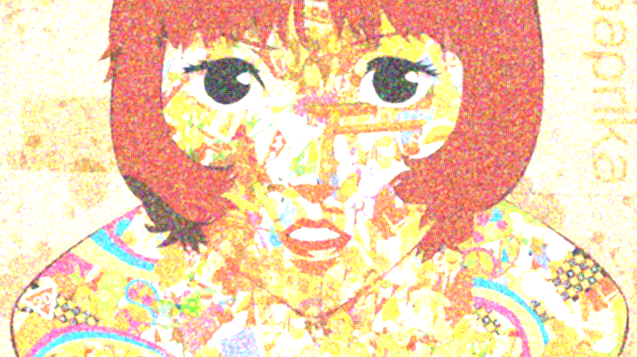

geom_mean


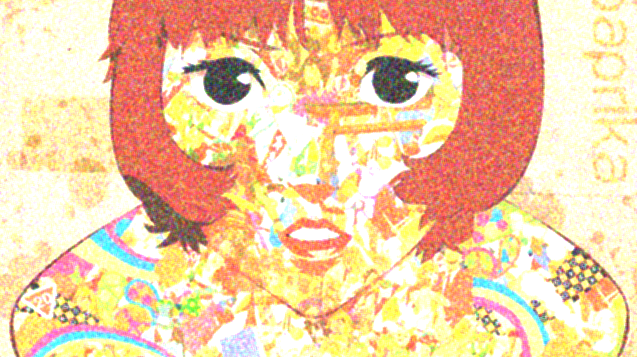

h_mean


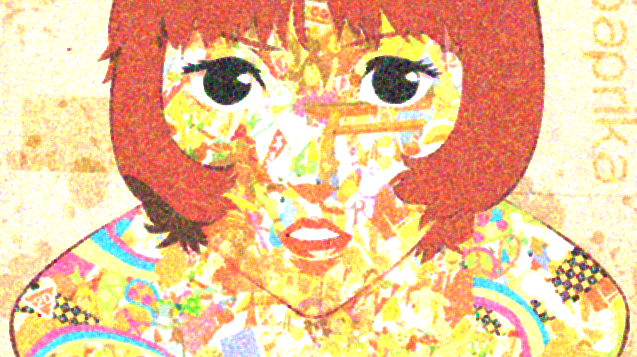

alpha-trimmed mean


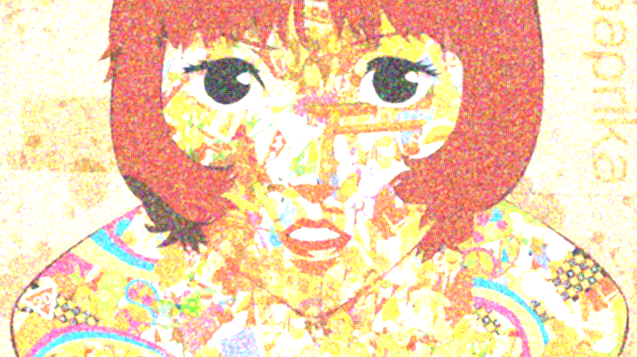

median


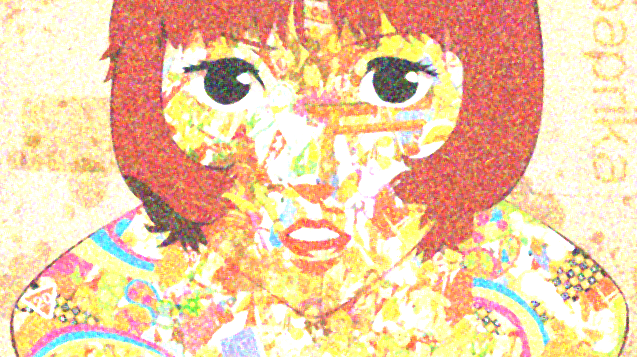

max


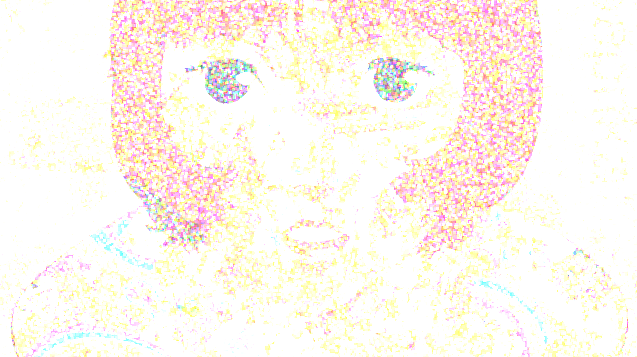

min


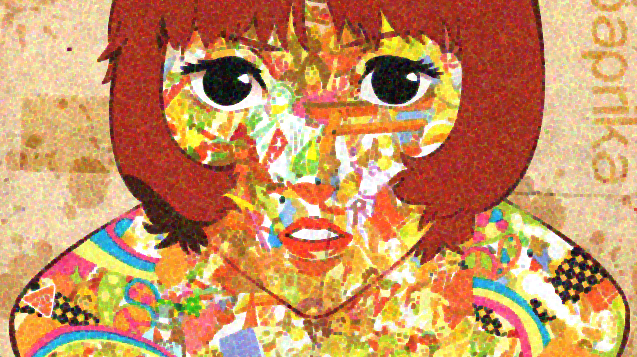

midpoint


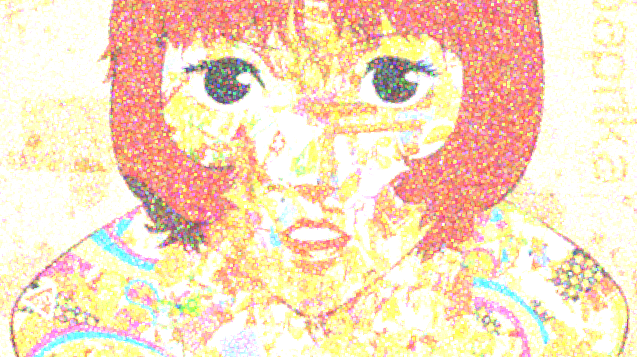

~~~~~~~~~~~exponential~~~~~~~~~~~
mean


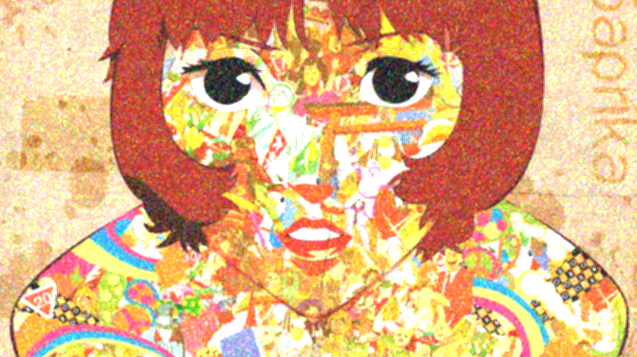

geom_mean


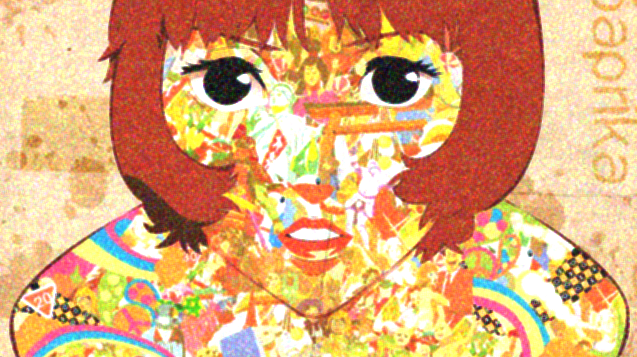

h_mean


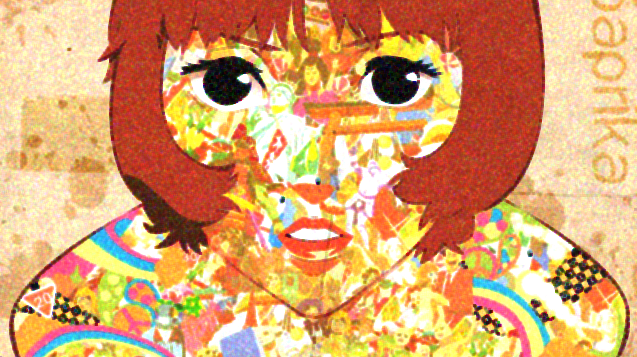

alpha-trimmed mean


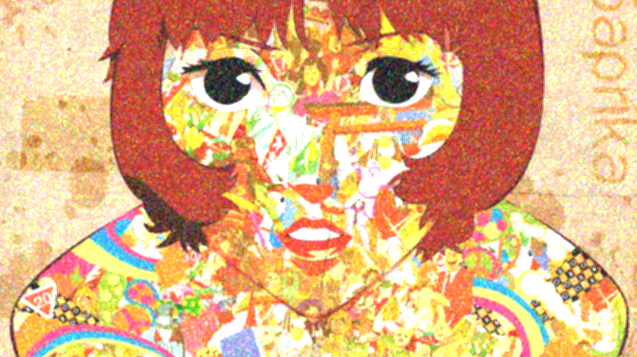

median


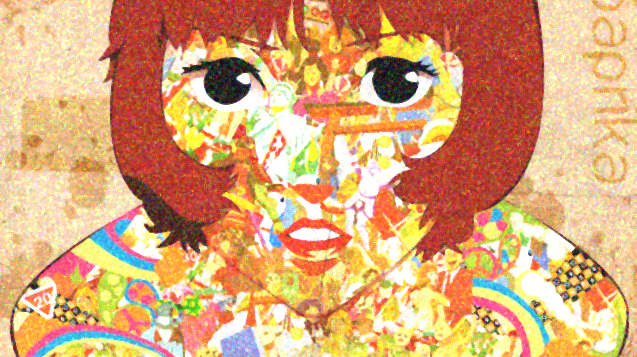

max


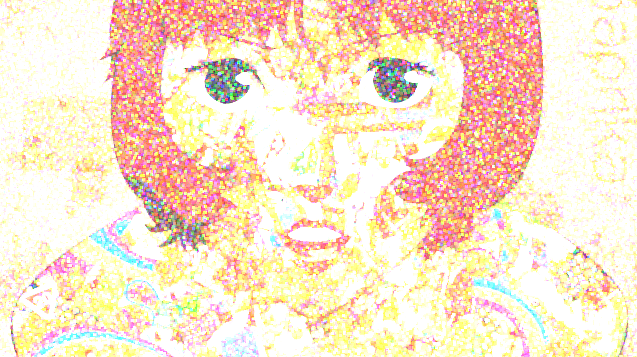

min


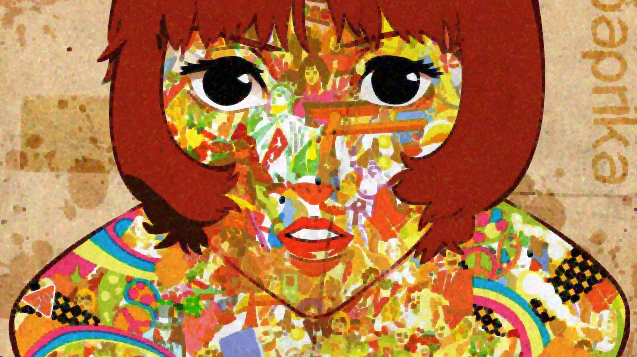

midpoint


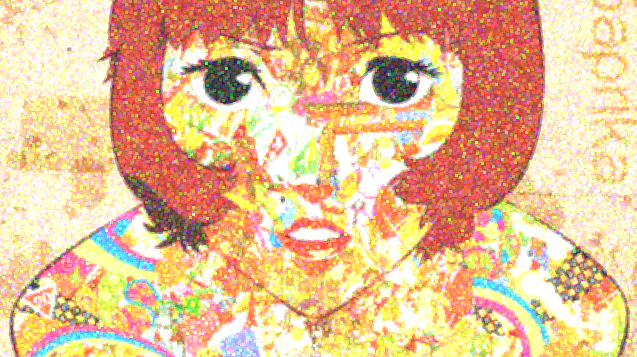

~~~~~~~~~~~uniform~~~~~~~~~~~
mean


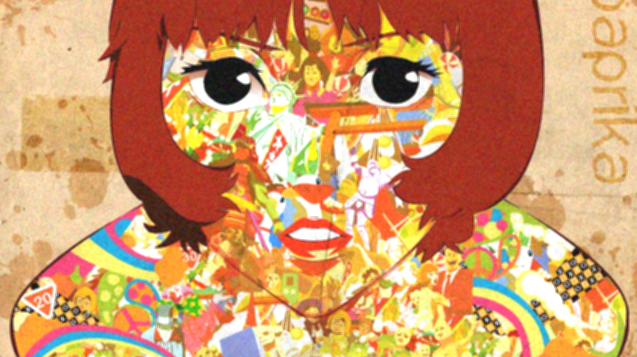

geom_mean


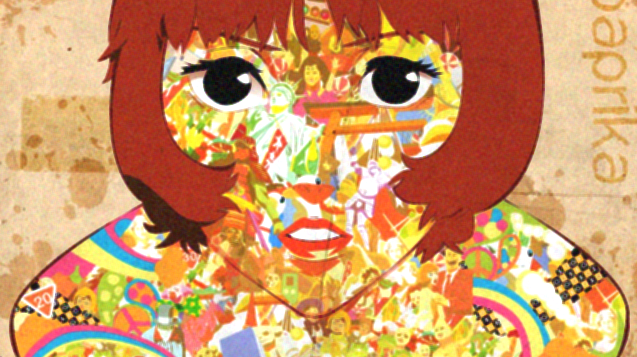

h_mean


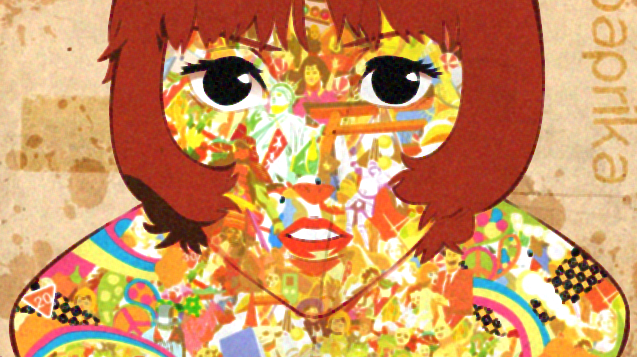

alpha-trimmed mean


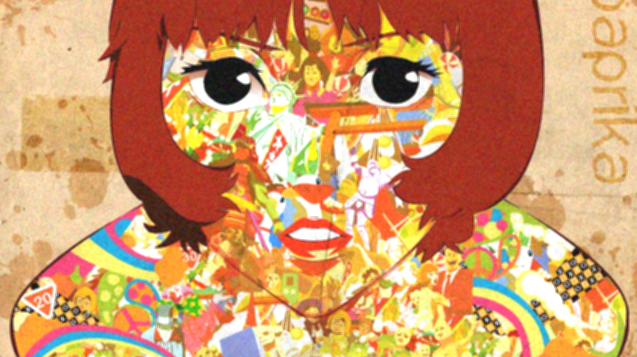

median


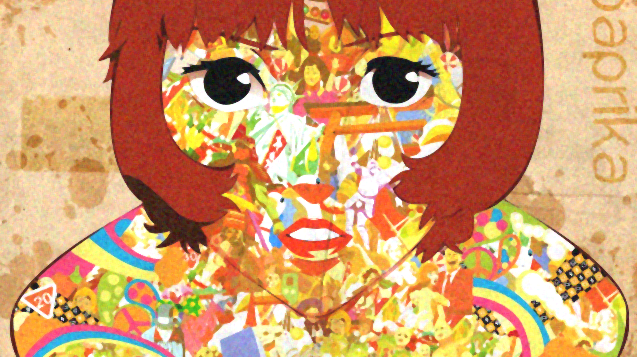

max


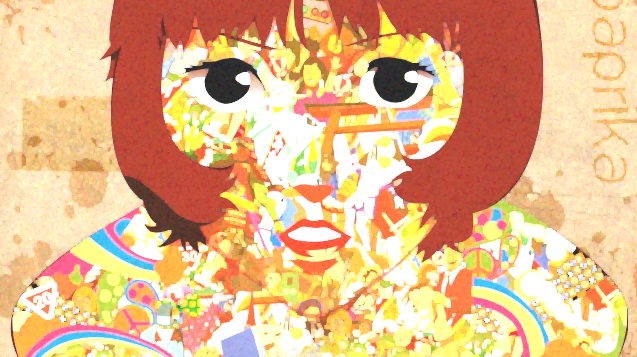

min


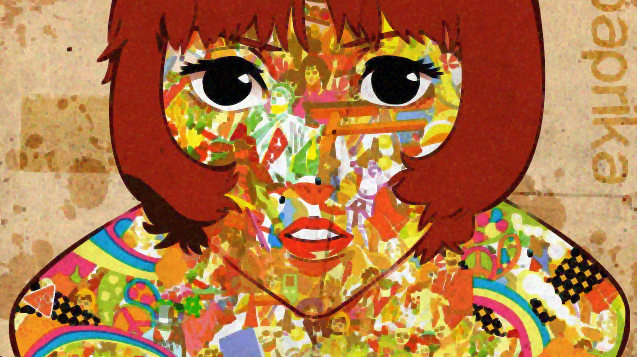

midpoint


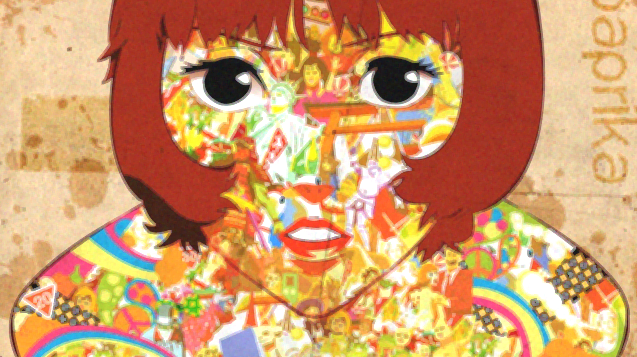

In [ ]:
## Now we run the denoising functions on the different noisy images and see 
## how they did:

for key, image in noised_h.items():
  print('~~~~~~~~~~~'+key+'~~~~~~~~~~~')
  den = try_denoising(image)
  for den_type, d_image in den.items():
    print(den_type)
    imshow(d_image)


## We still see the noise, for pretty much all of the images, but we notice that
## what we were concerned with for the midpoint is no longer a concern when 
## the noise was added

~~~~~~~~~~~gaussian~~~~~~~~~~~


/usr/local/lib/python3.6/dist-packages/scipy/stats/stats.py:338: RuntimeWarning: divide by zero encountered in log
  log_a = np.log(a)


mean


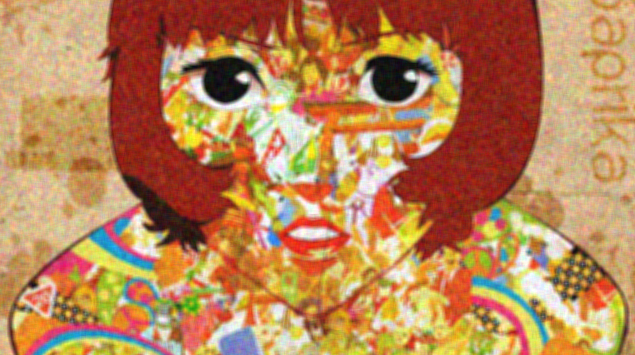

geom_mean


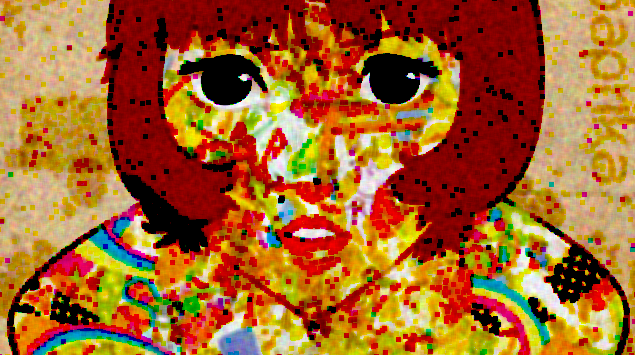

h_mean


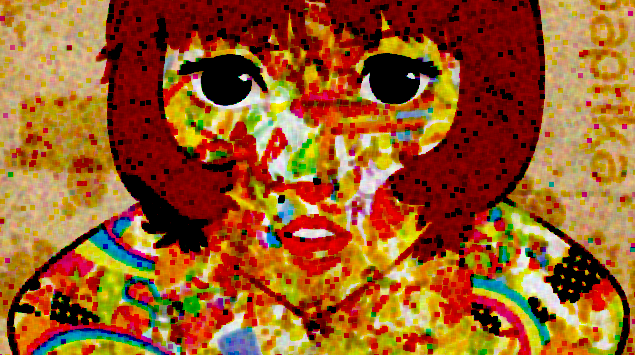

alpha-trimmed mean


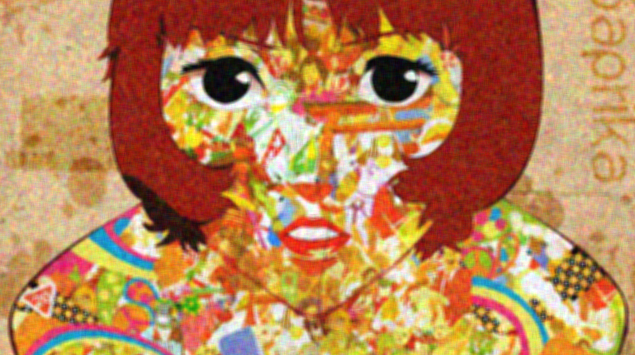

median


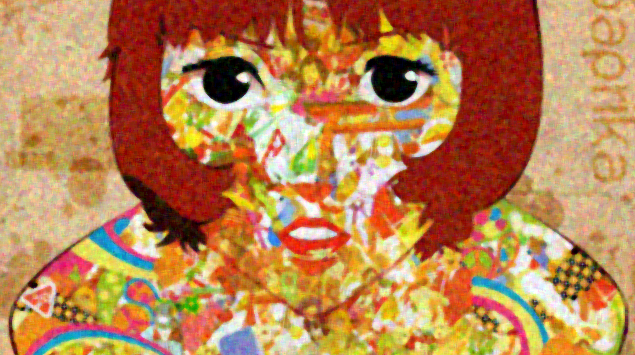

max


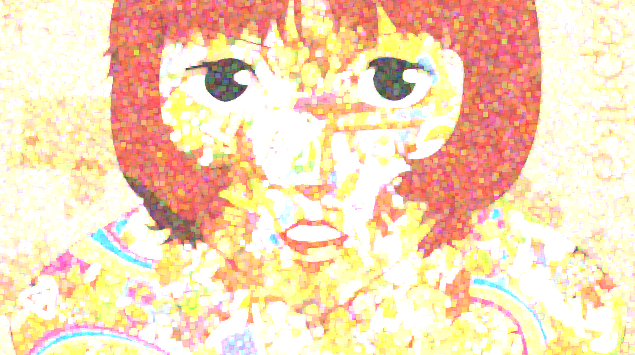

min


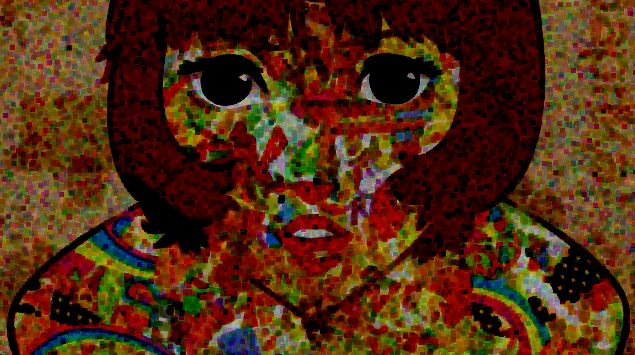

midpoint


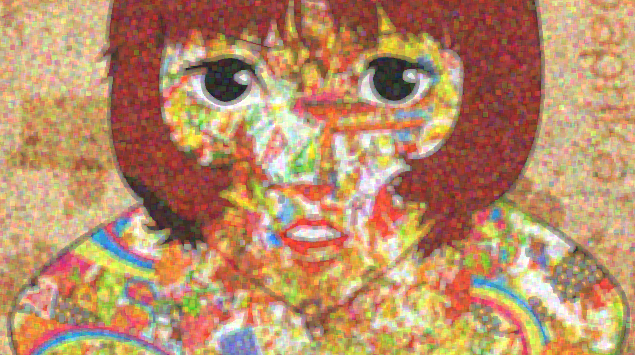

~~~~~~~~~~~rayleigh~~~~~~~~~~~
mean


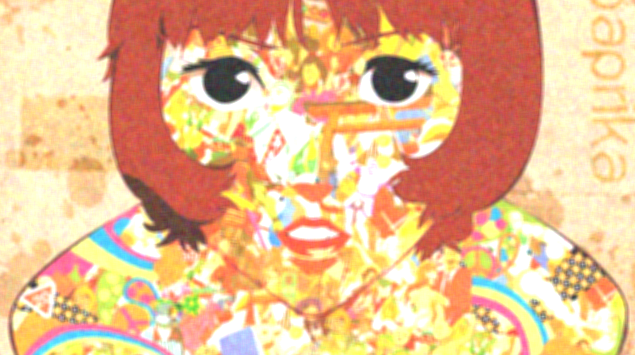

geom_mean


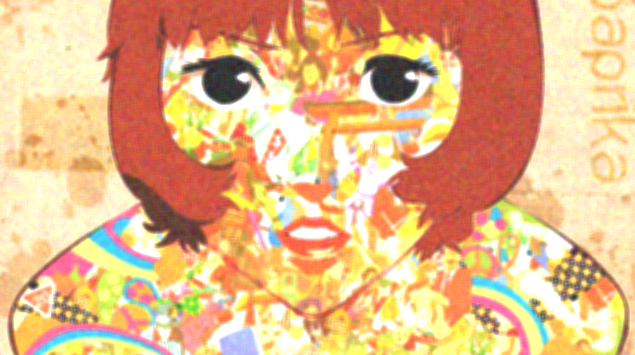

h_mean


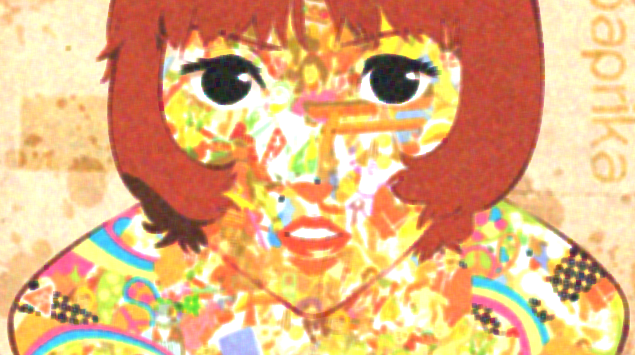

alpha-trimmed mean


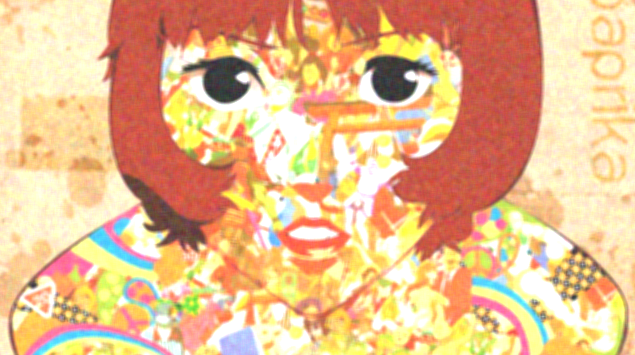

median


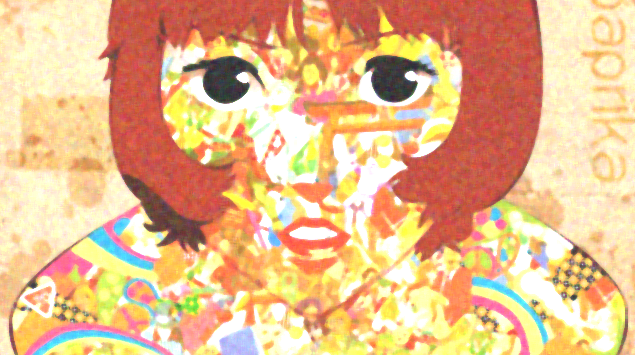

max


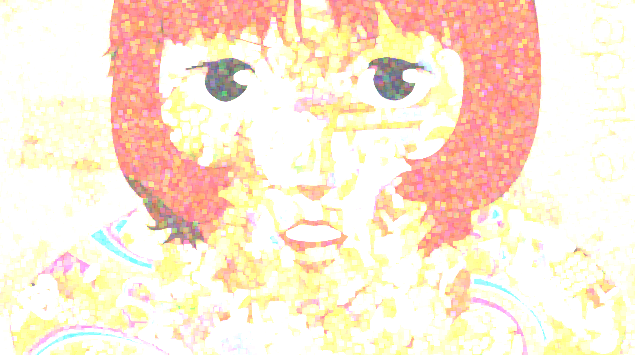

min


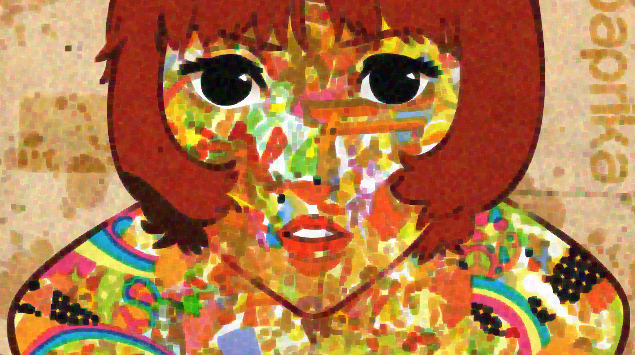

midpoint


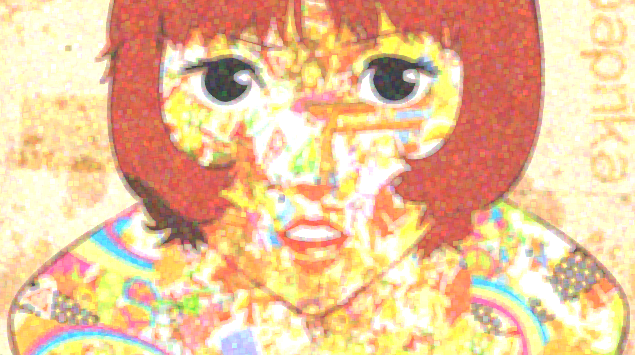

~~~~~~~~~~~gamma~~~~~~~~~~~
mean


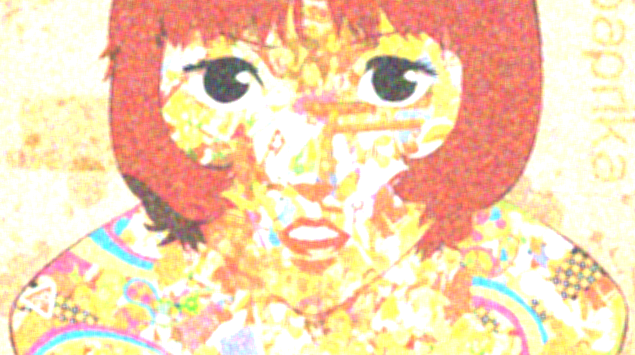

geom_mean


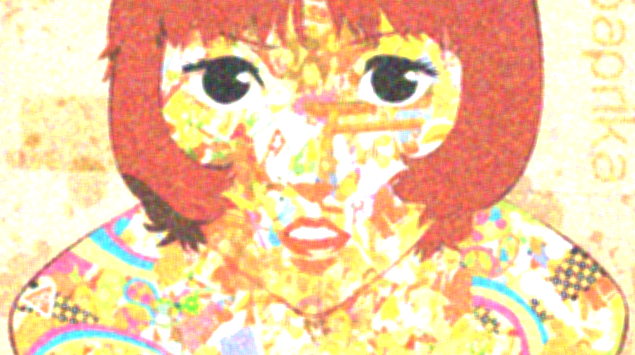

h_mean


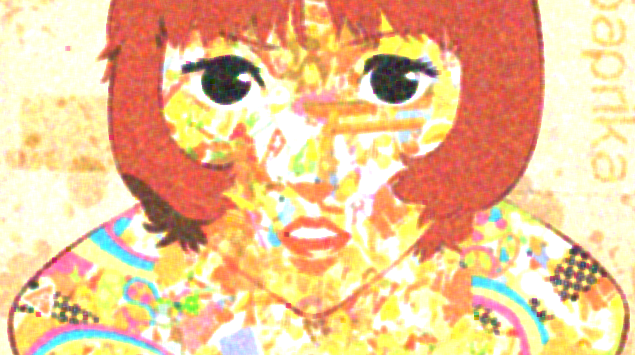

alpha-trimmed mean


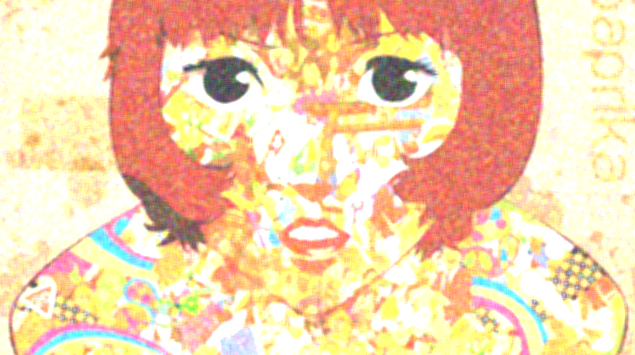

median


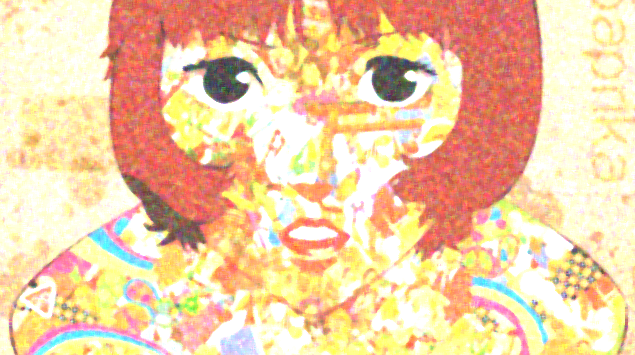

max


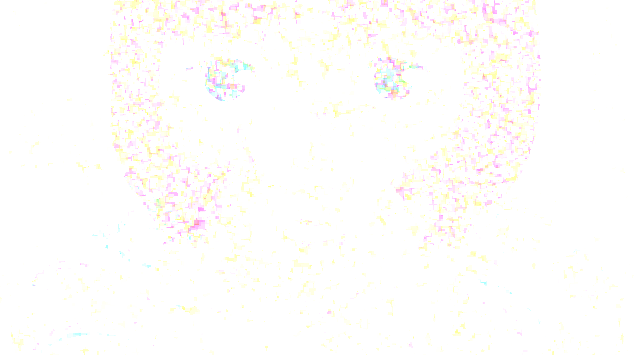

min


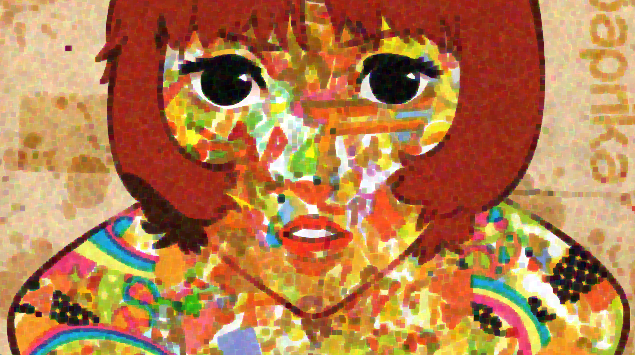

midpoint


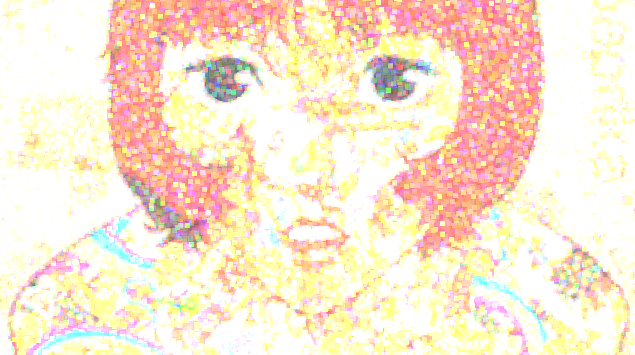

~~~~~~~~~~~exponential~~~~~~~~~~~
mean


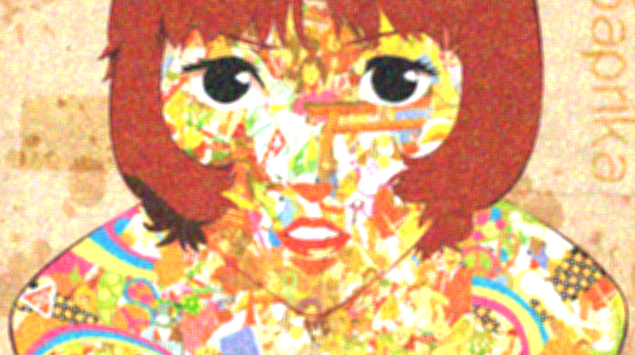

geom_mean


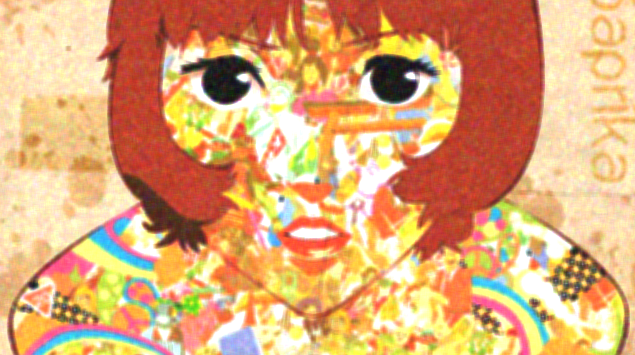

h_mean


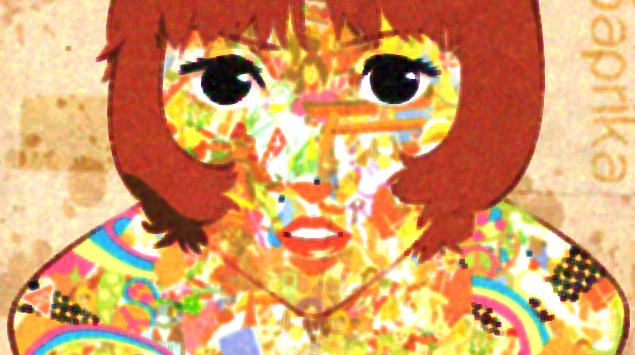

alpha-trimmed mean


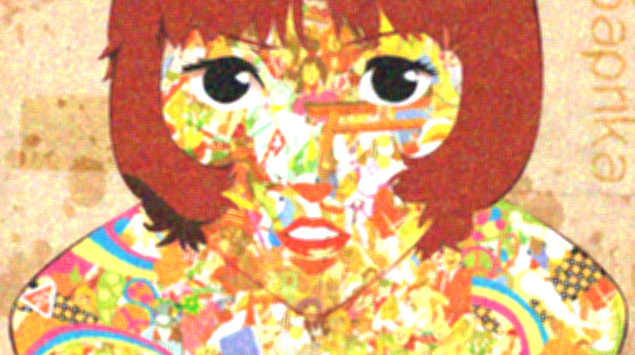

median


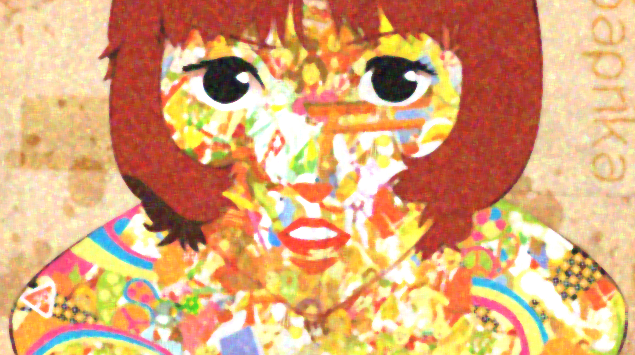

max


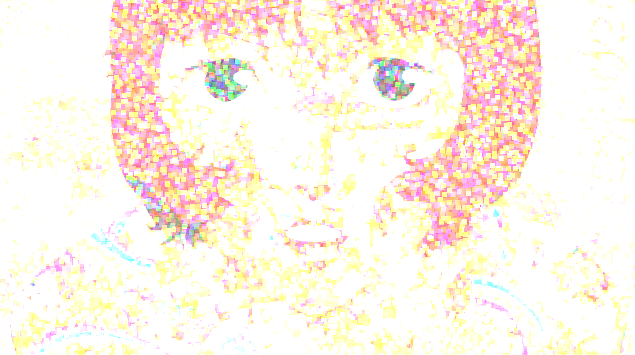

min


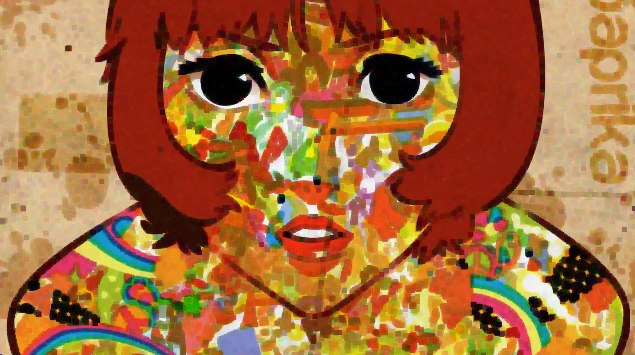

midpoint


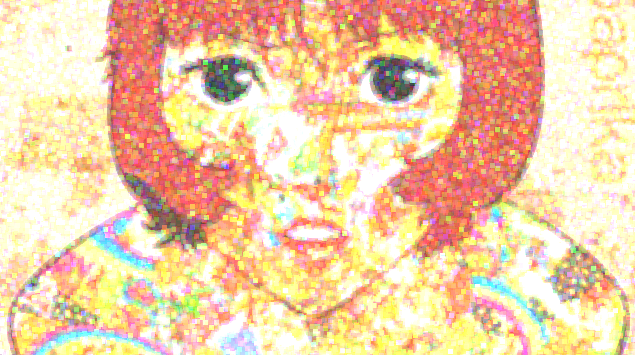

~~~~~~~~~~~uniform~~~~~~~~~~~
mean


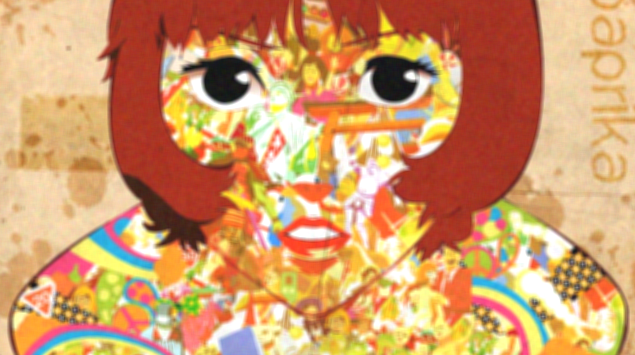

geom_mean


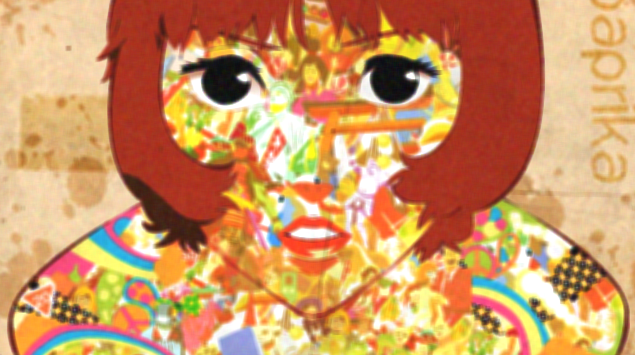

h_mean


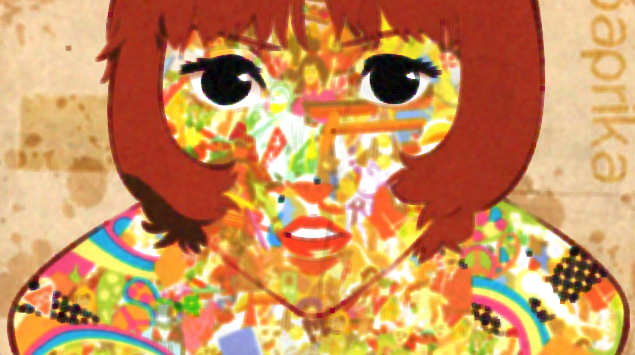

alpha-trimmed mean


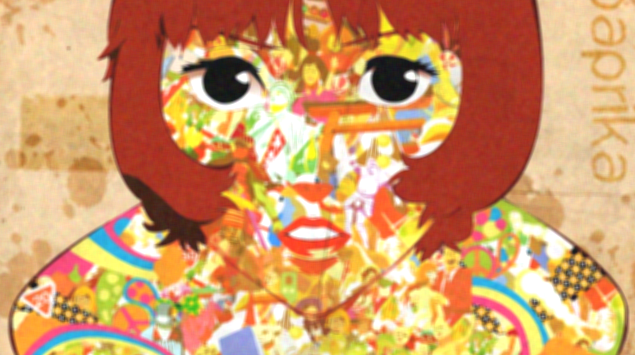

median


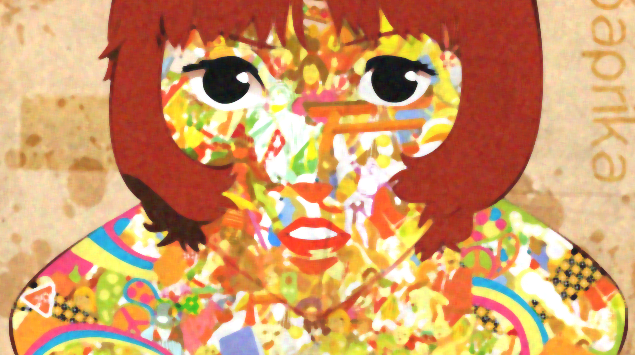

max


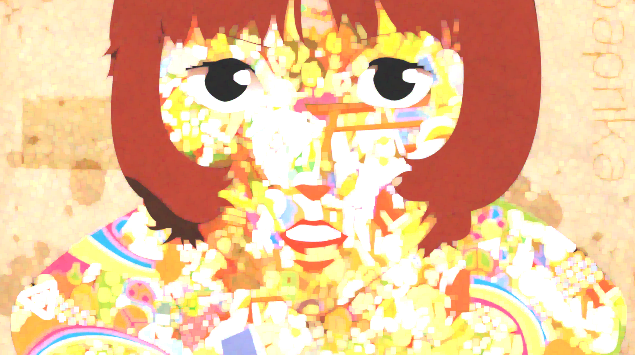

min


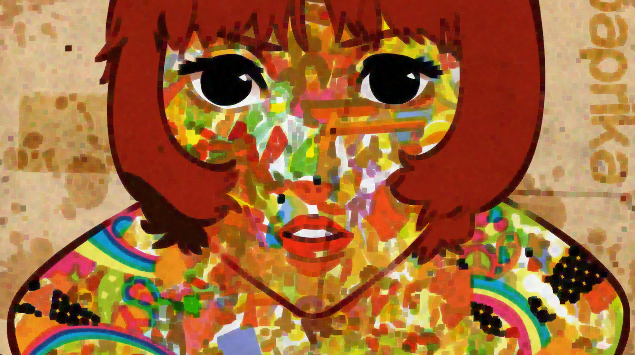

midpoint


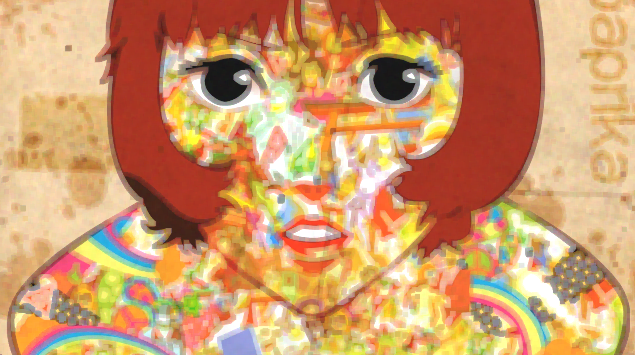

In [ ]:
## Maybe bigger filter will allow us to get rid of the noise better
for key, image in noised_h.items():
  print('~~~~~~~~~~~'+key+'~~~~~~~~~~~')
  den = try_denoising(image, size =(5,5))
  for den_type, d_image in den.items():
    print(den_type)
    imshow(d_image)


## As expected, everything seems much more blurry than before. We still see
## noticable noise as well. 